In [ ]:
import numpy as np
import sympy as sp
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
import matplotlib.animation as animation

#ecuaciones (x,y) para cada bolita

$x_1 = l_1 \sin(\theta_1), \quad y_1 = -l_1 \cos(\theta_1)$

$x_2 = x_1 + l_2 \sin(\theta_2), \quad y_2 = -y_1 - l_2 \cos(\theta_2)$

$x_2 = l_1 \sin(\theta_1) + l_2 \sin(\theta_2), \quad y_2 = -\left[l_1 \cos(\theta_1) + l_2 \cos(\theta_2)\right]$

$x_3 = l_1 \sin(\theta_1) + l_2 \sin(\theta_2) + l_3 \sin(\theta_3), \quad y_3 = -\left[l_1 \cos(\theta_1) + l_2 \cos(\theta_2) + l_3 \cos(\theta_3)\right]$




#derivada de la poscicion nesesarias para la graganiana
$$
\dot{x}_1 = l_1 \dot{\theta}_1 \cos(\theta_1), \quad \dot{y}_1 = l_1 \dot{\theta}_1 \sin(\theta_1)
$$

$$
\dot{x}_2 = l_1 \dot{\theta}_1 \cos(\theta_1) + l_2 \dot{\theta}_2 \cos(\theta_2), \quad
\dot{y}_2 = l_1 \dot{\theta}_1 \sin(\theta_1) + l_2 \dot{\theta}_2 \sin(\theta_2)
$$

$$
\dot{x}_3 = l_1 \dot{\theta}_1 \cos(\theta_1) + l_2 \dot{\theta}_2 \cos(\theta_2) + l_3 \dot{\theta}_3 \cos(\theta_3), \quad
\dot{y}_3 = l_1 \dot{\theta}_1 \sin(\theta_1) + l_2 \dot{\theta}_2 \sin(\theta_2) + l_3 \dot{\theta}_3 \sin(\theta_3)
$$



### Finalmente la energía cinética del sistema es:

$$
T = \frac{1}{2} m_1 l_1^2 \dot{\theta}_1^2 + \frac{1}{2} m_2 \left[ l_1^2 \dot{\theta}_1^2 + 2 l_1 l_2 \dot{\theta}_1 \dot{\theta}_2 \cos(\theta_2 - \theta_1) + l_2^2 \dot{\theta}_2^2 \right]
$$

$$
+ \frac{1}{2} m_3 \left[ l_1^2 \dot{\theta}_1^2 + 2 l_1 l_2 \dot{\theta}_1 \dot{\theta}_2 \cos(\theta_2 - \theta_1) + l_2^2 \dot{\theta}_2^2 + 2 l_1 l_3 \dot{\theta}_1 \dot{\theta}_3 \cos(\theta_3 - \theta_1) + 2 l_2 l_3 \dot{\theta}_2 \dot{\theta}_3 \cos(\theta_3 - \theta_2) + l_3^2 \dot{\theta}_3^2 \right]
$$

$$
T = \frac{1}{2} (m_1 + m_2 + m_3) l_1^2 \dot{\theta}_1^2 + (m_2 + m_3) l_1 l_2 \dot{\theta}_1 \dot{\theta}_2 \cos(\theta_2 - \theta_1) + m_3 l_1 l_3 \dot{\theta}_1 \dot{\theta}_3 \cos(\theta_3 - \theta_1)
$$

$$
+ m_3 l_2 l_3 \dot{\theta}_2 \dot{\theta}_3 \cos(\theta_3 - \theta_2) + \frac{1}{2} (m_2 + m_3) l_2^2 \dot{\theta}_2^2 + \frac{1}{2} m_3 l_3^2 \dot{\theta}_3^2
$$

### La energía potencial del sistema es:

$$
U = m_1 g y_1 + m_2 g y_2 + m_3 g y_3
$$


Llamemos \( a_{ij} \) a los factores que acompañan a las aceleraciones
\( \ddot{\theta}_1, \ddot{\theta}_2, \ddot{\theta}_3 \) y
\( b_1, b_2, b_3 \) a los elementos que están del otro lado de la igualdad, así:

$$
a_{11} = (m_1 + m_2 + m_3) l_1^2  \quad ; \quad a_{12} = (m_2 + m_3) l_1 l_2 \cos(\theta_2 - \theta_1) \quad ; \quad a_{13} = m_3 l_1 l_3 \cos(\theta_3 - \theta_1)
$$

$$
a_{21} = (m_2 + m_3) l_1 l_2 \cos(\theta_2 - \theta_1) \quad ; \quad a_{22} = (m_2 + m_3) l_2^2  \quad ; \quad a_{23} = m_3 l_2 l_3 \cos(\theta_3 - \theta_2)
$$

$$
a_{31} = m_3 l_1 l_3 \cos(\theta_3 - \theta_1) \quad ; \quad a_{32} = m_3 l_2 l_3 \cos(\theta_3 - \theta_2) \quad ; \quad a_{33} = m_3 l_3^2
$$


$$ b_1 = (m_2 + m_3) l_1 l_2 \dot{\theta}_2^2 \sin (\theta_2 - \theta_1) + m_3 l_1 l_3 \dot{\theta}_3^2 \sin (\theta_3 - \theta_1) - (m_1 + m_2 + m_3) g l_1 \sin (\theta_1) $$

$$ b_2 = m_3 l_2 l_3 \dot{\theta}_3^2 \sin (\theta_3 - \theta_2) - (m_2 + m_3) l_1 l_2 \dot{\theta}_1^2 \sin (\theta_2 - \theta_1) - (m_2 + m_3) g l_2 \sin (\theta_2) $$

$$ b_3 = - m_3 l_1 l_3 \dot{\theta}_1^2 \sin (\theta_3 - \theta_1) - m_3 l_2 l_3 \dot{\theta}_2^2 \sin (\theta_3 - \theta_2) - m_3 g l_3 \sin (\theta_3) $$


El conjunto de ecuaciones que conforman al sistema ahora es:

$$
a_{11} \ddot{\theta}_1 + a_{12} \ddot{\theta}_2 + a_{13} \ddot{\theta}_3 = b_1
$$

$$
a_{21} \ddot{\theta}_1 + a_{22} \ddot{\theta}_2 + a_{23} \ddot{\theta}_3 = b_2
$$

$$
a_{31} \ddot{\theta}_1 + a_{32} \ddot{\theta}_2 + a_{33} \ddot{\theta}_3 = b_3
$$


El valor de \( \ddot{\theta}_1 \) se halla a partir del determinante del sistema:

$$
\ddot{\theta}_1 = \frac{1}{D}
\begin{vmatrix}
b_1 & a_{12} & a_{13} \\
b_2 & a_{22} & a_{23} \\
b_3 & a_{32} & a_{33}
\end{vmatrix}
$$

$$
\Rightarrow \ddot{\theta}_1 = \frac{1}{D} \left[ b_1 (a_{22} a_{33} - a_{23} a_{32}) - a_{12} (b_2 a_{33} - a_{23} b_3) + a_{13} (b_2 a_{32} - a_{22} b_3) \right]
$$

Arreglando los valores para hallar \( \ddot{\theta}_2 \) a partir del determinante del sistema:

$$
\ddot{\theta}_2 = \frac{1}{D}
\begin{vmatrix}
a_{11} & b_1 & a_{13} \\
a_{21} & b_2 & a_{23} \\
a_{31} & b_3 & a_{33}
\end{vmatrix}
$$

$$
\Rightarrow \ddot{\theta}_2 = \frac{1}{D} \left[ a_{11} (b_2 a_{33} - a_{23} b_3) - b_1 (a_{21} a_{33} - a_{23} a_{31}) + a_{13} (a_{21} b_3 - b_2 a_{31}) \right]
$$

Arreglando nuevamente los valores para hallar \( \ddot{\theta}_3 \) a partir del determinante del sistema:

$$
\ddot{\theta}_3 = \frac{1}{D}
\begin{vmatrix}
a_{11} & a_{12} & b_1 \\
a_{21} & a_{22} & b_2 \\
a_{31} & a_{32} & b_3
\end{vmatrix}
$$

$$
\Rightarrow \ddot{\theta}_3 = \frac{1}{D} \left[ a_{11} (a_{22} b_3 - b_2 a_{32}) - a_{12} (a_{21} b_3 - b_2 a_{31}) + b_1 (a_{21} a_{32} - a_{22} a_{31}) \right]
$$


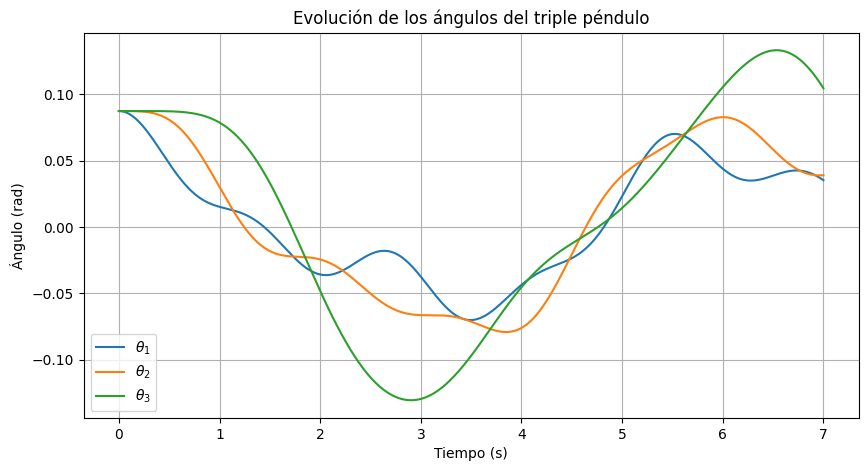

In [ ]:
# Definimos constantes
g = -9.8  # m/s^2
m1, l1 = 4, 2
m2, l2 = 4, 4
m3, l3 = 4, 6

# Matriz A (simbólica) (matriz asociada a la inercia del sistema)
Θ1, Θ2, Θ3 = sp.symbols('Θ1 Θ2 Θ3')
A = sp.Matrix([
    [(m1 + m2 + m3) * (l1**2), (m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), m3 * l1 * l3 * sp.cos(Θ3 - Θ1)],
    [(m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), (m2 + m3) * (l2**2), m3 * l2 * l3 * sp.cos(Θ3 - Θ2)],
    [m3 * l1 * l3 * sp.cos(Θ3 - Θ1), m3 * l2 * l3 * sp.cos(Θ3 - Θ2), m3 * (l3**2)]
])
A_func = sp.lambdify((Θ1, Θ2, Θ3), A, "numpy")

# Definimos la función que describe el sistema de ecuaciones diferenciales
def deriv(t, y):
    Θ1, Θ2, Θ3, dΘ1, dΘ2, dΘ3 = y

    # Calculamos la matriz A con los valores actuales
    A_num = A_func(Θ1, Θ2, Θ3)

    # Vector b (vectores de fuerzas)
    b1 = (m2 + m3) * l1 * l2 * dΘ2**2 * np.sin(Θ2 - Θ1) \
         + m3 * l1 * l3 * dΘ3**2 * np.sin(Θ3 - Θ1) \
         - (m1 + m2 + m3) * g * l1 * np.sin(Θ1)

    b2 = m3 * l2 * l3 * dΘ3**2 * np.sin(Θ3 - Θ2) \
         - (m2 + m3) * l1 * l2 * dΘ1**2 * np.sin(Θ2 - Θ1) \
         - (m2 + m3) * g * l2 * np.sin(Θ2)

    b3 = -m3 * l1 * l3 * dΘ1**2 * np.sin(Θ3 - Θ1) \
         - m3 * l2 * l3 * dΘ2**2 * np.sin(Θ3 - Θ2) \
         - m3 * g * l3 * np.sin(Θ3)

    # Resolver el sistema A ddΘ = b para obtener ddΘ
    b_vec = np.array([b1, b2, b3])
    ddΘ = np.linalg.solve(A_num, b_vec)

    return [dΘ1, dΘ2, dΘ3, ddΘ[0], ddΘ[1], ddΘ[2]]

# Condiciones iniciales
y0 = [np.pi*37/36, np.pi*37/36, np.pi*37/36, 0, 0, 0]

# Tiempo de simulación
t_span = (0, 7)
t_eval = np.linspace(0, 7, 1000)

# Resolver el sistema de ecuaciones diferenciales
sol = solve_ivp(deriv, t_span, y0, t_eval=t_eval, method='RK45')

# Extraer resultados
Θ1_vals, Θ2_vals, Θ3_vals = sol.y[0]-np.radians(180), sol.y[1]-np.radians(180), sol.y[2]-np.radians(180)

# Graficar los resultados
plt.figure(figsize=(10, 5))
plt.plot(sol.t, Θ1_vals, label=r'$\theta_1$')
plt.plot(sol.t, Θ2_vals, label=r'$\theta_2$')
plt.plot(sol.t, Θ3_vals, label=r'$\theta_3$')
plt.xlabel("Tiempo (s)")
plt.ylabel("Ángulo (rad)")
plt.legend()
plt.title("Evolución de los ángulos del triple péndulo")
plt.grid(True)
plt.show()

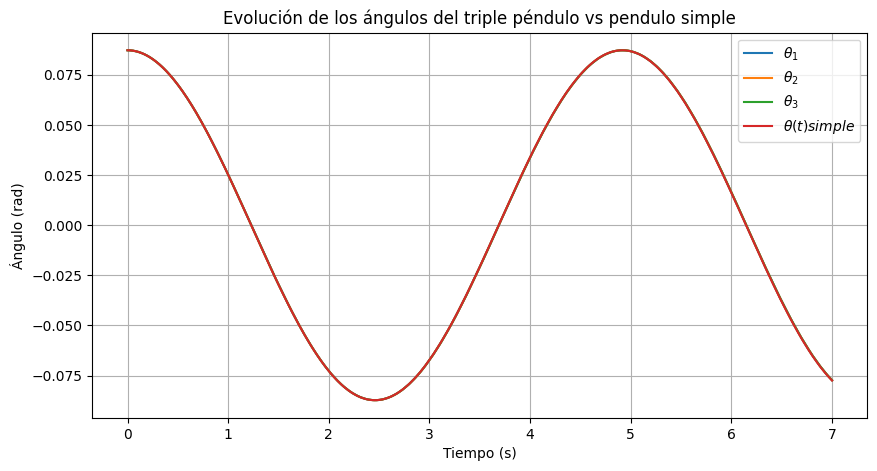

In [ ]:
#comparativa vs un pendulo simple

#parametros y calculos del pendulo simple
# Definir parámetros
ls1 = 6  # Longitud del péndulo (m), no tiene masa porque no afecta al calculo
g = 9.8   # Aceleración debido a la gravedad (m/s^2)
# Frecuencia angular
omega = np.sqrt(g / ls1)

# Pedir al usuario el ángulo inicial
theta0 = np.radians(5)  # Convertir a radianes

# Cálculo del ángulo usando la solución analítica para oscilaciones pequeñas
theta = theta0 * np.cos(omega * t_eval)


#parametros y calculos del pendulo triple con 2 masas suficientemente mas pequeñas que la tercera
g = -9.8  # m/s^2
m1, l1 = 0.0001, 2
m2, l2 = 0.0001, 2
m3, l3 = 1000, 2

Θ1, Θ2, Θ3 = sp.symbols('Θ1 Θ2 Θ3')
A = sp.Matrix([
    [(m1 + m2 + m3) * (l1**2), (m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), m3 * l1 * l3 * sp.cos(Θ3 - Θ1)],
    [(m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), (m2 + m3) * (l2**2), m3 * l2 * l3 * sp.cos(Θ3 - Θ2)],
    [m3 * l1 * l3 * sp.cos(Θ3 - Θ1), m3 * l2 * l3 * sp.cos(Θ3 - Θ2), m3 * (l3**2)]
])
A_func = sp.lambdify((Θ1, Θ2, Θ3), A, "numpy")

y0 = [np.pi*37/36, np.pi*37/36, np.pi*37/36, 0, 0, 0]
t_span = (0, 7)
t_eval = np.linspace(0, 7, 1000)

sol = solve_ivp(deriv, t_span, y0, t_eval=t_eval, method='RK45')

Θ1_vals, Θ2_vals, Θ3_vals = sol.y[0]-np.radians(180), sol.y[1]-np.radians(180), sol.y[2]-np.radians(180)

# Graficar los resultados
plt.figure(figsize=(10, 5))
plt.plot(sol.t, Θ1_vals, label=r'$\theta_1$')
plt.plot(sol.t, Θ2_vals, label=r'$\theta_2$')
plt.plot(sol.t, Θ3_vals, label=r'$\theta_3$')
plt.plot(t_eval, theta, label=r'$\theta(t) simple$')
plt.xlabel("Tiempo (s)")
plt.ylabel("Ángulo (rad)")
plt.legend()
plt.title("Evolución de los ángulos del triple péndulo vs pendulo simple")
plt.grid(True)
plt.show()

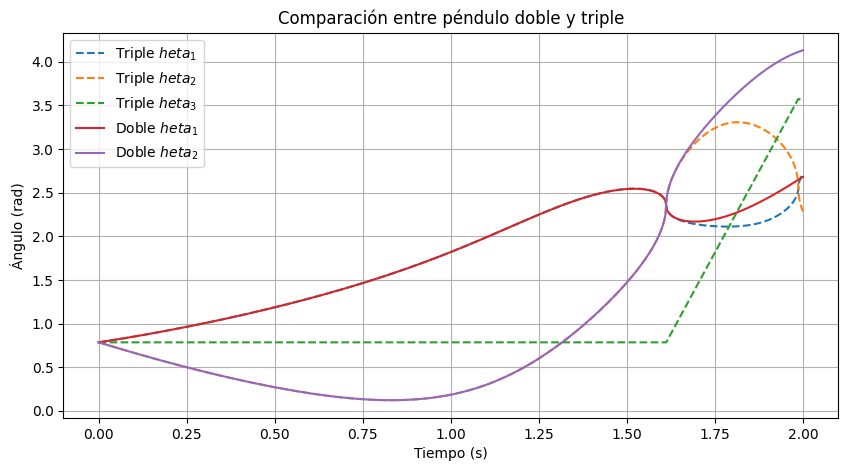

In [ ]:
import numpy as np
import sympy as sp
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

# Definimos constantes
g = -9.8  # m/s^2
m1, l1 = 0.00001, 6  # Primera masa insignificante y longitud total
m2, l2 = 1000, 3
m3, l3 = 1000, 3  # Para el triple, l1 + l2 = l1 del doble

# Matriz A para el péndulo triple
Θ1, Θ2, Θ3 = sp.symbols('Θ1 Θ2 Θ3')
A = sp.Matrix([
    [(m1 + m2 + m3) * (l1**2), (m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), m3 * l1 * l3 * sp.cos(Θ3 - Θ1)],
    [(m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), (m2 + m3) * (l2**2), m3 * l2 * l3 * sp.cos(Θ3 - Θ2)],
    [m3 * l1 * l3 * sp.cos(Θ3 - Θ1), m3 * l2 * l3 * sp.cos(Θ3 - Θ2), m3 * (l3**2)]
])
A_func = sp.lambdify((Θ1, Θ2, Θ3), A, 'numpy')

def deriv(t, y):
    Θ1, Θ2, Θ3, dΘ1, dΘ2, dΘ3 = y
    A_num = A_func(Θ1, Θ2, Θ3)
    b1 = (m2 + m3) * l1 * l2 * dΘ2**2 * np.sin(Θ2 - Θ1) + m3 * l1 * l3 * dΘ3**2 * np.sin(Θ3 - Θ1) - (m1 + m2 + m3) * g * l1 * np.sin(Θ1)
    b2 = m3 * l2 * l3 * dΘ3**2 * np.sin(Θ3 - Θ2) - (m2 + m3) * l1 * l2 * dΘ1**2 * np.sin(Θ2 - Θ1) - (m2 + m3) * g * l2 * np.sin(Θ2)
    b3 = -m3 * l1 * l3 * dΘ1**2 * np.sin(Θ3 - Θ1) - m3 * l2 * l3 * dΘ2**2 * np.sin(Θ3 - Θ2) - m3 * g * l3 * np.sin(Θ3)
    b_vec = np.array([b1, b2, b3])
    ddΘ = np.linalg.solve(A_num, b_vec)
    return [dΘ1, dΘ2, dΘ3, ddΘ[0], ddΘ[1], ddΘ[2]]

# Matriz A2 para el péndulo doble
Θ1, Θ2 = sp.symbols('Θ1 Θ2')
A2 = sp.Matrix([
    [(m1 + m2) * (l1**2), m2 * l1 * l2 * sp.cos(Θ2 - Θ1)],
    [m2 * l1 * l2 * sp.cos(Θ2 - Θ1), m2 * (l2**2)]
])
A2_func = sp.lambdify((Θ1, Θ2), A2, 'numpy')

def deriv2(t, y):
    Θ1, Θ2, dΘ1, dΘ2 = y
    A2_num = A2_func(Θ1, Θ2)
    b1 = m2 * l1 * l2 * dΘ2**2 * np.sin(Θ2 - Θ1) - (m1 + m2) * g * l1 * np.sin(Θ1)
    b2 = -m2 * l1 * l2 * dΘ1**2 * np.sin(Θ2 - Θ1) - m2 * g * l2 * np.sin(Θ2)
    b_vec = np.array([b1, b2])
    ddΘ = np.linalg.solve(A2_num, b_vec)
    return [dΘ1, dΘ2, ddΘ[0], ddΘ[1]]

# Condiciones iniciales
y0_triple = [np.pi / 4, np.pi / 4, np.pi / 4, 0, 0, 0]
y0_doble = [np.pi / 4, np.pi / 4, 0, 0]

# Tiempo
t_span = (0, 2)
t_eval = np.linspace(0, 2, 1000)

# Resolver ecuaciones
t_sol = solve_ivp(deriv, t_span, y0_triple, t_eval=t_eval, method='RK45')
d_sol = solve_ivp(deriv2, t_span, y0_doble, t_eval=t_eval, method='RK45')

# Extraer soluciones
Θ1_t, Θ2_t, Θ3_t = t_sol.y[0], t_sol.y[1], t_sol.y[2]
Θ1_d, Θ2_d = d_sol.y[0], d_sol.y[1]

# Graficar resultados
plt.figure(figsize=(10, 5))
plt.plot(t_sol.t, Θ1_t, label='Triple $\theta_1$', linestyle='dashed')
plt.plot(t_sol.t, Θ2_t, label='Triple $\theta_2$', linestyle='dashed')
plt.plot(t_sol.t, Θ3_t, label='Triple $\theta_3$', linestyle='dashed')
plt.plot(d_sol.t, Θ1_d, label='Doble $\theta_1$', linestyle='solid')
plt.plot(d_sol.t, Θ2_d, label='Doble $\theta_2$', linestyle='solid')
plt.xlabel("Tiempo (s)")
plt.ylabel("Ángulo (rad)")
plt.legend()
plt.title("Comparación entre péndulo doble y triple")
plt.grid()
plt.show()

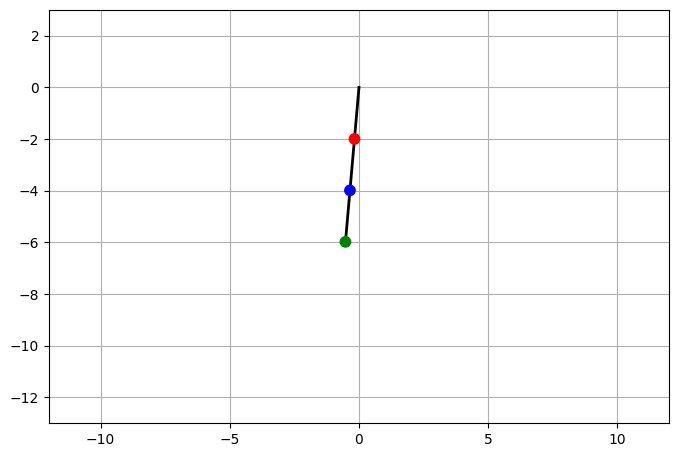

In [ ]:
g = -9.8  # m/s^2
m1, l1 = 100, 2
m2, l2 = 100, 2
m3, l3 = 100, 2

Θ1, Θ2, Θ3 = sp.symbols('Θ1 Θ2 Θ3')
A = sp.Matrix([
    [(m1 + m2 + m3) * (l1**2), (m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), m3 * l1 * l3 * sp.cos(Θ3 - Θ1)],
    [(m2 + m3) * l1 * l2 * sp.cos(Θ2 - Θ1), (m2 + m3) * (l2**2), m3 * l2 * l3 * sp.cos(Θ3 - Θ2)],
    [m3 * l1 * l3 * sp.cos(Θ3 - Θ1), m3 * l2 * l3 * sp.cos(Θ3 - Θ2), m3 * (l3**2)]
])
A_func = sp.lambdify((Θ1, Θ2, Θ3), A, "numpy")

y0 = [np.pi*37/36, np.pi*37/36, np.pi*37/36, 0, 0, 0]
t_span = (0, 7)
t_eval = np.linspace(0, 7, 1000)

sol = solve_ivp(deriv, t_span, y0, t_eval=t_eval, method='RK45')

Θ1_vals, Θ2_vals, Θ3_vals = sol.y[0]-np.radians(180), sol.y[1]-np.radians(180), sol.y[2]-np.radians(180)



# Parámetros del péndulo
r1 = 0.2  # Radio de los cuerpos
l1, l2, l3 = 2, 2, 2

# Inicializar figura
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xlim(-12, 12)
ax.set_ylim(-13, 3)
ax.set_aspect('equal')
ax.grid(True)

# Inicializar líneas y círculos
line, = ax.plot([], [], 'k-', linewidth=2)  # Línea que conecta los cuerpos
circle1 = plt.Circle((0, 0), r1, color='red', zorder=3)
circle2 = plt.Circle((0, 0), r1, color='blue', zorder=3)
circle3 = plt.Circle((0, 0), r1, color='green', zorder=3)
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)

def update(frame):
    # Obtener los valores actuales de theta
    th1, th2, th3 = Θ1_vals[frame], Θ2_vals[frame], Θ3_vals[frame]

    # Calcular posiciones de los cuerpos
    x1, y1 = l1 * np.sin(th1+np.pi), l1 * np.cos(th1+np.pi)
    x2, y2 = x1 + l2 * np.sin(th2+np.pi), y1 + l2 * np.cos(th2+np.pi)
    x3, y3 = x2 + l3 * np.sin(th3+np.pi), y2 + l3 * np.cos(th3+np.pi)

    # Actualizar la posición de los círculos
    circle1.set_center((x1, y1))
    circle2.set_center((x2, y2))
    circle3.set_center((x3, y3))

    # Actualizar la línea que conecta los cuerpos
    line.set_data([0, x1, x2, x3], [0, y1, y2, y3])

    return circle1, circle2, circle3, line

# Crear animación
ani = animation.FuncAnimation(fig, update, frames=len(t_eval), interval=50, blit=False)

# Mostrar la animación en Jupyter Notebook
from IPython.display import HTML
HTML(ani.to_jshtml())